https://data.cityofnewyork.us/Public-Safety/NYPD-Calls-for-Service-Year-to-Date-/n2zq-pubd/about_data

In [3]:
!pip install folium

   ---------------------------------------- 0.0/110.9 kB ? eta -:--:--
   --- ------------------------------------ 10.2/110.9 kB ? eta -:--:--
   ---------- ---------------------------- 30.7/110.9 kB 435.7 kB/s eta 0:00:01
   ---------------------------- ---------- 81.9/110.9 kB 657.6 kB/s eta 0:00:01
   -------------------------------------- 110.9/110.9 kB 713.8 kB/s eta 0:00:00


In [2]:
import folium

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
df = pd.read_csv('NYPD_Calls_for_Service__Year_to_Date__20250419.csv')
df.head()

,CAD_EVNT_ID,CREATE_DATE,INCIDENT_DATE,INCIDENT_TIME,NYPD_PCT_CD,BORO_NM,PATRL_BORO_NM,GEO_CD_X,GEO_CD_Y,RADIO_CODE,TYP_DESC,CIP_JOBS,ADD_TS,DISP_TS,ARRIVD_TS,CLOSNG_TS,Latitude,Longitude
0,108642792,01/01/2025,12/31/2024,23:22:32,116.0,(null),(null),1056625,180527,53S,VEHICLE ACCIDENT: SPECIAL CONDITION,Non CIP,01/01/2025 12:44:37 AM,01/01/2025 12:45:19 AM,01/01/2025 01:21:05 AM,01/01/2025 01:21:07 AM,40.661894,-73.739133
1,108643213,01/01/2025,12/31/2024,23:58:23,52.0,BRONX,PATROL BORO BRONX,1013953,255677,54I2,AMBULANCE CASE: INJURY/OUTSIDE,Non CIP,01/01/2025 12:17:38 AM,01/01/2025 12:19:56 AM,01/01/2025 12:20:50 AM,01/01/2025 12:39:14 AM,40.868407,-73.892608
2,108643225,01/01/2025,01/01/2025,00:00:08,84.0,BROOKLYN,PATROL BORO BKLYN NORTH,987351,193828,75S,STATION INSPECTION BY TRANSIT BUREAU PERSONNEL,Non CIP,01/01/2025 12:00:08 AM,01/01/2025 12:00:08 AM,01/01/2025 12:00:08 AM,01/01/2025 12:42:04 AM,40.698698,-73.988818
3,108643226,01/01/2025,01/01/2025,00:00:43,70.0,BROOKLYN,PATROL BORO BKLYN SOUTH,993152,168419,50G2,DISORDERLY: GROUP/OUTSIDE,Non CIP,01/01/2025 12:00:44 AM,01/01/2025 12:38:50 AM,01/01/2025 01:35:33 AM,01/01/2025 02:06:57 AM,40.628952,-73.967931
4,108643227,01/01/2025,01/01/2025,00:00:49,13.0,MANHATTAN,PATROL BORO MAN SOUTH,987653,210944,10H1,INVESTIGATE/POSSIBLE CRIME: CALLS FOR HELP/INSIDE,Non CIP,01/01/2025 12:00:49 AM,01/01/2025 12:13:25 AM,NaN,01/01/2025 12:19:14 AM,40.745677,-73.987720


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1702561 entries, 0 to 1702560
Data columns (total 18 columns):
 #   Column         Dtype  
---  ------         -----  
 0   CAD_EVNT_ID    int64  
 1   CREATE_DATE    object 
 2   INCIDENT_DATE  object 
 3   INCIDENT_TIME  object 
 4   NYPD_PCT_CD    float64
 5   BORO_NM        object 
 6   PATRL_BORO_NM  object 
 7   GEO_CD_X       int64  
 8   GEO_CD_Y       int64  
 9   RADIO_CODE     object 
 10  TYP_DESC       object 
 11  CIP_JOBS       object 
 12  ADD_TS         object 
 13  DISP_TS        object 
 14  ARRIVD_TS      object 
 15  CLOSNG_TS      object 
 16  Latitude       float64
 17  Longitude      float64
dtypes: float64(3), int64(3), object(12)
memory usage: 233.8+ MB


In [8]:
df.columns

Index(['CAD_EVNT_ID', 'CREATE_DATE', 'INCIDENT_DATE', 'INCIDENT_TIME',
       'NYPD_PCT_CD', 'BORO_NM', 'PATRL_BORO_NM', 'GEO_CD_X', 'GEO_CD_Y',
       'RADIO_CODE', 'TYP_DESC', 'CIP_JOBS', 'ADD_TS', 'DISP_TS', 'ARRIVD_TS',
       'CLOSNG_TS', 'Latitude', 'Longitude'],
      dtype='object')

In [9]:
df.isnull().sum()

CAD_EVNT_ID           0
CREATE_DATE           0
INCIDENT_DATE         0
INCIDENT_TIME         0
NYPD_PCT_CD           2
BORO_NM               0
PATRL_BORO_NM         0
GEO_CD_X              0
GEO_CD_Y              0
RADIO_CODE            0
TYP_DESC              0
CIP_JOBS              0
ADD_TS                0
DISP_TS               0
ARRIVD_TS        329064
CLOSNG_TS            21
Latitude              0
Longitude             0
dtype: int64

In [11]:
df.describe()
pd.set_option('display.float_format', '{:.2f}'.format)


In [12]:
df.describe()

,CAD_EVNT_ID,NYPD_PCT_CD,GEO_CD_X,GEO_CD_Y,Latitude,Longitude
count,1702561.00,1702559.00,1702561.00,1702561.00,1702561.00,1702561.00
mean,109687681.69,62.24,1003466.00,206087.69,40.73,-73.93
std,601893.98,34.56,20849.93,29896.28,0.08,0.08
min,108642792.00,0.00,913411.00,121174.00,40.50,-74.25
25%,109167211.00,33.00,990011.00,183852.00,40.67,-73.98
50%,109689145.00,63.00,1001765.00,204312.00,40.73,-73.94
75%,110208868.00,88.00,1014322.00,233097.00,40.81,-73.89
max,110727865.00,123.00,1067305.00,272307.00,40.91,-73.70


Данных очень много-столбцы содержат около 1,7 млн записей
средняя широта и долгота соответствует Нью-Йорку

In [13]:
# Кол-во вызовов по районам 
df.groupby('BORO_NM')['CAD_EVNT_ID'].count()

BORO_NM
(null)            11239
BRONX            327988
BROOKLYN         540656
MANHATTAN        446559
QUEENS           302054
STATEN ISLAND     74065
Name: CAD_EVNT_ID, dtype: int64

In [14]:
df['BORO_NM'].isnull().sum()

0

Значения null в BORO_NM - это строка

In [15]:
df= df[df['BORO_NM'] != '(null)']

In [16]:
df['BORO_NM'].unique()

array(['BRONX', 'BROOKLYN', 'MANHATTAN', 'QUEENS', 'STATEN ISLAND'],
      dtype=object)

In [17]:
df.groupby('BORO_NM')['CAD_EVNT_ID'].count()foik

BORO_NM
BRONX            327988
BROOKLYN         540656
MANHATTAN        446559
QUEENS           302054
STATEN ISLAND     74065
Name: CAD_EVNT_ID, dtype: int64

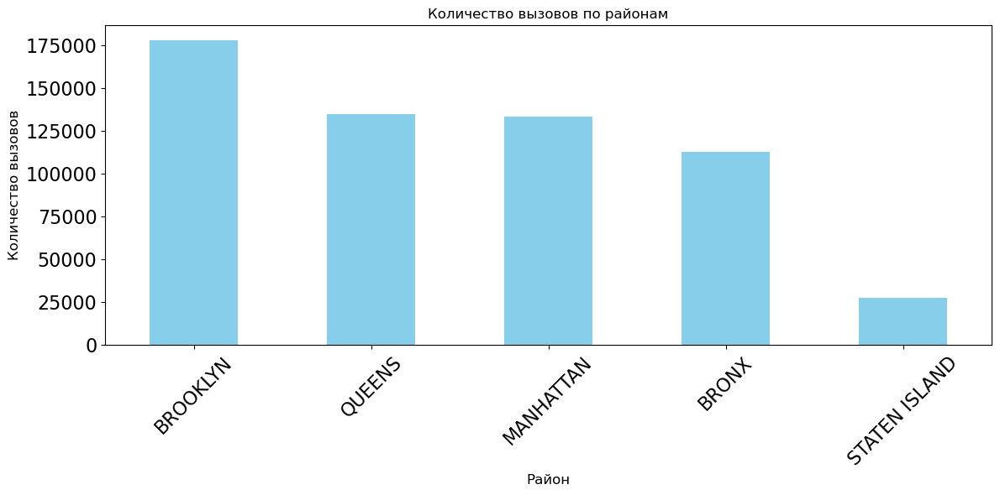

In [206]:
plt.figure(figsize=(12,6))
# фильтрация данных: убираем записи, где район BORO_NM равен "(null)" 
# groupby('BORO_NM') — группируем данные по названию района
# ['CAD_EVNT_ID'].count() — считаем количество вызовов (CAD_EVNT_ID) в каждом районе
# sort_values(ascending=False) — сортируем районы от большего количества вызовов к меньшему.
calls_by_bor = df[df['BORO_NM'] != '(null)'].groupby('BORO_NM')['CAD_EVNT_ID'].count().sort_values(ascending=False)
calls_by_bor.plot(kind='bar', color='skyblue', title='Количество вызовов по районам',fontsize=16)
plt.xlabel('Район', fontsize=12)
plt.ylabel('Количество вызовов', fontsize=12)
plt.xticks(rotation=45); plt.tight_layout();

Бруклин — самый населённый район Нью-Йорка

Больше людей = больше инцидентов, больше вызовов полиции, скорой помощи и 
пожарных

In [202]:
df['TYP_DESC'].value_counts()

TYP_DESC
SEE COMPLAINANT: OTHER/INSIDE                        33641
INVESTIGATE/POSSIBLE CRIME: CALLS FOR HELP/INSIDE    33410
VISIBILITY PATROL: DIRECTED                          29805
DISPUTE: FAMILY                                      27710
ALARMS: COMMERCIAL/BURGLARY                          24768
                                                     ...  
DISORDERLY: NOISE/LTD ACC HWY                            1
COMMUNITY EVENT                                          1
OTHER-CRIME INCIDENT: MARIJUANA/OUTSIDE                  1
FIRE: EXPLOSION/LTD ACC HWY                              1
AMBULANCE CASE: SEVERED LIMB/TRANSIT                     1
Name: count, Length: 430, dtype: int64

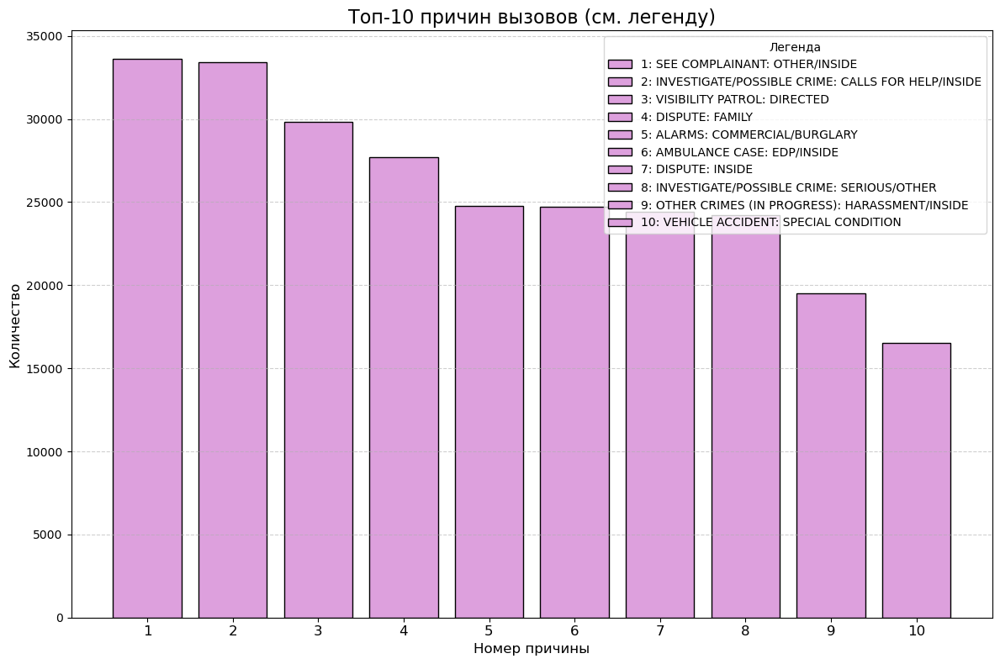

In [204]:
# Самые частые причины вызовов
top_types = df['TYP_DESC'].value_counts().head(10)
# enumerate - чтобы получить и индекс, и значение
# словарь, который: К каждой причине присваивает номер (1, 2, 3, ... 10)
# Причина: {1: "ASSAULT", 2: "ROBBERY", ...}
labels_map = {i+1: desc for i, desc in enumerate(top_types.index)}
keys = list(labels_map.keys())
# keys — это список чисел от 1 до 10 (номера причин).
# values — это список количеств вызовов для каждой причины
values = list(top_types.values)

fig, ax = plt.subplots(figsize=(12, 8))
bars = []
for i, (x, y) in enumerate(zip(keys, values)):
    # Строится один столбик (bar) для каждой причины
    bar = ax.bar(x, y, color='plum', edgecolor='black', label=f"{x}: {labels_map[x]}")
    bars.append(bar)
ax.set_title('Топ-10 причин вызовов (см. легенду)', fontsize=16)
ax.set_xlabel('Номер причины', fontsize=12)
ax.set_ylabel('Количество', fontsize=12)
# На оси X отображаются числа (1–10), а не текстовые названия причин.
# Это делается специально, чтобы легенда объясняла, что означает каждая цифра
ax.set_xticks(keys)
ax.set_xticklabels(keys, fontsize=12); ax.grid(axis='y', linestyle='--', alpha=0.6)
ax.legend(title='Легенда', fontsize=10); plt.tight_layout();

In [208]:
# Количество вызовов по участкам полиции
df.groupby("NYPD_PCT_CD")['CAD_EVNT_ID'].count().sort_values(ascending=False).head(10)


NYPD_PCT_CD
75.0     16192
114.0    13318
109.0    12720
73.0     12034
40.0     11989
52.0     11716
44.0     11553
67.0     11466
47.0     11440
43.0     11275
Name: CAD_EVNT_ID, dtype: int64

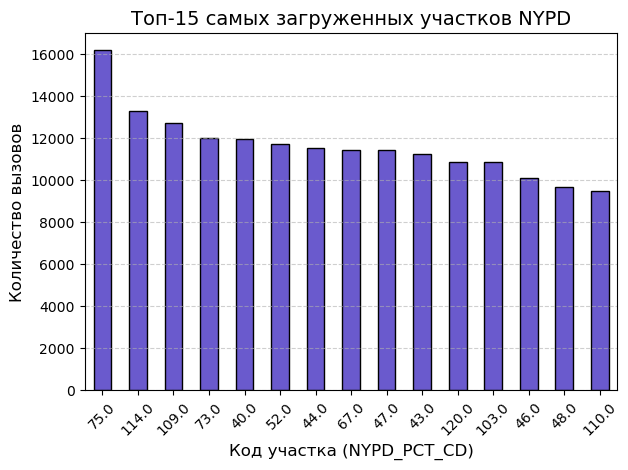

In [210]:
df.groupby("NYPD_PCT_CD")['CAD_EVNT_ID'].count().sort_values(ascending=False).head(15).plot(kind='bar', color='slateblue', edgecolor='black')
plt.title('Топ-15 самых загруженных участков NYPD', fontsize=14)
plt.xlabel('Код участка (NYPD_PCT_CD)', fontsize=12)
plt.ylabel('Количество вызовов', fontsize=12)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.6); plt.tight_layout();

In [212]:
# столбец CREATE_DATE в формат даты и времени (datetime).
# errors='coerce' означает: Если есть неправильные значения, они будут заменены на NaT (Not a Time), а не вызовут ошибку
df["CREATE_DATE"] = pd.to_datetime(df["CREATE_DATE"], errors='coerce')
# это только дата без времени
# .size() — подсчитывает количество вызовов для каждой даты
df.groupby(df["CREATE_DATE"].dt.date).size()


CREATE_DATE
2025-01-01    5452
2025-01-02    6504
2025-01-03    6716
2025-01-04    6188
2025-01-05    5976
              ... 
2025-03-27    6576
2025-03-28    7195
2025-03-29    7221
2025-03-30    6445
2025-03-31    6751
Length: 90, dtype: int64

.size()	Считает все строки в группе, включая пропуски	
.count()	Считает только непустые значения в конкретном столбце

In [214]:
calls_by_day = df.groupby(df["CREATE_DATE"].dt.date).size()

In [216]:
# преобразование индекса (ось X, которая состоит из дат) в настоящий datetime тип
# Это важно, чтобы потом легко обращаться к атрибутам типа .weekday, .month, .year и т.д.
calls_by_day.index = pd.to_datetime(calls_by_day.index)

In [218]:
weekend_days = calls_by_day[calls_by_day.index.weekday >= 5]

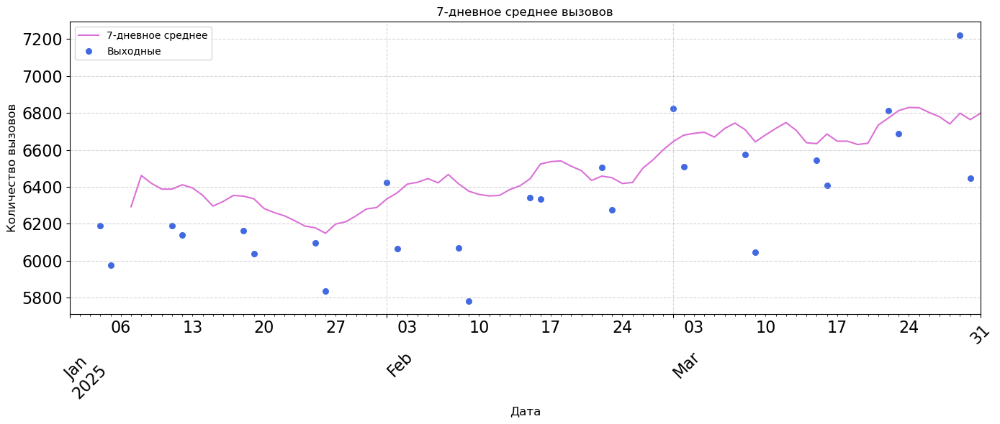

In [220]:
plt.figure(figsize=(14, 6))
3
calls_by_day.rolling(window=7).mean().plot(color='orchid', label='7-дневное среднее', title="7-дневное среднее вызовов", fontsize=16)
plt.scatter(weekend_days.index, weekend_days.values, color='royalblue', s=30, label='Выходные')

plt.xlabel("Дата", fontsize=12)
plt.ylabel("Количество вызовов", fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5); plt.xticks(rotation=45); plt.legend(); plt.tight_layout();

Делает скользящее среднее по 7 дням.
То есть, каждое значение — это среднее за последнюю неделю

Строим точки (scatter) на тех местах, где дни — это суббота или воскресенье
ВыделяемЫ на общем графике выходные дни

В начале января уровень вызовов был чуть ниже (~6000–6300 вызовов в день).

В феврале начался плавный рост.

К марту видно устойчивое повышение активности  уровень поднялся ближе к 6800–7000 вызовов в день.

Вывод: Количество вызовов постепенно увеличивается в течение первых месяцев 2025 года.

Синие точки (выходные) распределены довольно равномерно.

В большинстве случаев:

В выходные количество вызовов немного ниже, чем в будние дни.

Иногда есть всплески активности в выходные (видны более высокие точки)

In [ ]:
df["is_weekend"] = df["CREATE_DATE"].dt.weekday >= 5
daily_calls = df.groupby(["CREATE_DATE", "is_weekend"]).size().reset_index(name="count")

In [224]:
daily_calls.groupby("is_weekend")["count"].mean()

is_weekend
False    6569.671875
True     6326.384615
Name: count, dtype: float64

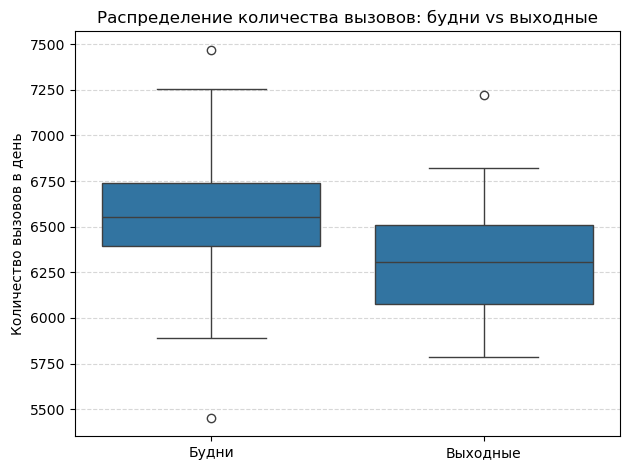

In [226]:
sns.boxplot(data=daily_calls, x="is_weekend", y="count").set_title("Распределение количества вызовов: будни vs выходные")
plt.xticks([0, 1], ["Будни", "Выходные"])
plt.ylabel("Количество вызовов в день")
plt.xlabel(""); plt.grid(axis='y', linestyle='--', alpha=0.5); plt.tight_layout();


Будни: медиана количества вызовов выше (~6600–6700).

Выходные: медиана ниже (~6300).
    
В будние дни в среднем происходит больше вызовов, чем в выходные.

Широкий ящик (IQR — интерквартильный размах) → разброс в количестве вызовов по будням выше

Более узкий ящик → количество вызовов на выходных более стабильно, меньше "разбросано".

На обеих группах есть точки за пределами "усов":

Очень высокие значения (пики вызовов) и

Очень низкие значения (спады активности).

Иногда случаются аномальные дни — возможно, праздники, сильные погодные условия или чрезвычайные происшествия

Среднее время реагирования по типу вызова

In [229]:
df["DISP_TS"] = pd.to_datetime(df["DISP_TS"], format="%m/%d/%Y %I:%M:%S %p", errors='coerce')

In [231]:
df["ARRIVD_TS"] = pd.to_datetime(df["ARRIVD_TS"], format="%m/%d/%Y %I:%M:%S %p", errors="coerce")

In [233]:
# Вычисляем время реакции между отправкой и прибытием (ARRIVD_TS - DISP_TS) в минутах.
df["response_min"] = (df["ARRIVD_TS"] - df["DISP_TS"]).dt.total_seconds() / 60

In [235]:
df.groupby("TYP_DESC")["response_min"].mean().sort_values()


TYP_DESC
VISIBILITY PATROL: WARRANT CHECK                   0.033333
COMMUNITY EVENT                                    0.033333
ALL OUT DIRECTED                                   0.038095
DISABLED VEHICLE                                   0.050000
AMBULANCE CASE: OTHER/SCHOOL                       0.445833
                                                    ...    
LARCENY (PAST): OTHER/OUTSIDE                     92.380308
OTHER CRIMES (PAST): OTHER/INSIDE                 94.877664
LARCENY (PAST): VEHICLE/SCHOOL                   119.433333
INVESTIGATE/POSSIBLE CRIME: OTHER/LTD ACC HWY    215.000000
LARCENY (PAST): OTHER/LTD ACC HWY                220.133333
Name: response_min, Length: 430, dtype: float64

In [237]:
df = df[df["response_min"].notna() & (df["response_min"] > 0)]
# Оставляем только те строки, где response_min не NaN

In [239]:
df.groupby("TYP_DESC")["response_min"].mean().sort_values(ascending=False).head(10)


TYP_DESC
LARCENY (PAST): OTHER/LTD ACC HWY                220.133333
INVESTIGATE/POSSIBLE CRIME: OTHER/LTD ACC HWY    215.000000
LARCENY (PAST): VEHICLE/SCHOOL                   119.433333
OTHER CRIMES (PAST): OTHER/INSIDE                 94.877664
LARCENY (PAST): OTHER/OUTSIDE                     92.380308
LARCENY (PAST): VEHICLE/INSIDE                    91.686374
LARCENY (PAST): VEHICLE/OUTSIDE                   89.229693
OTHER NON-CRIME INCIDENT: NARCO SALE/OUTSIDE      88.650000
DISABLED VEHICLE: LTD ACC HWY                     88.011111
FIRE: OUTSIDE RUBBISH/LTD ACC HWY                 87.750000
Name: response_min, dtype: float64

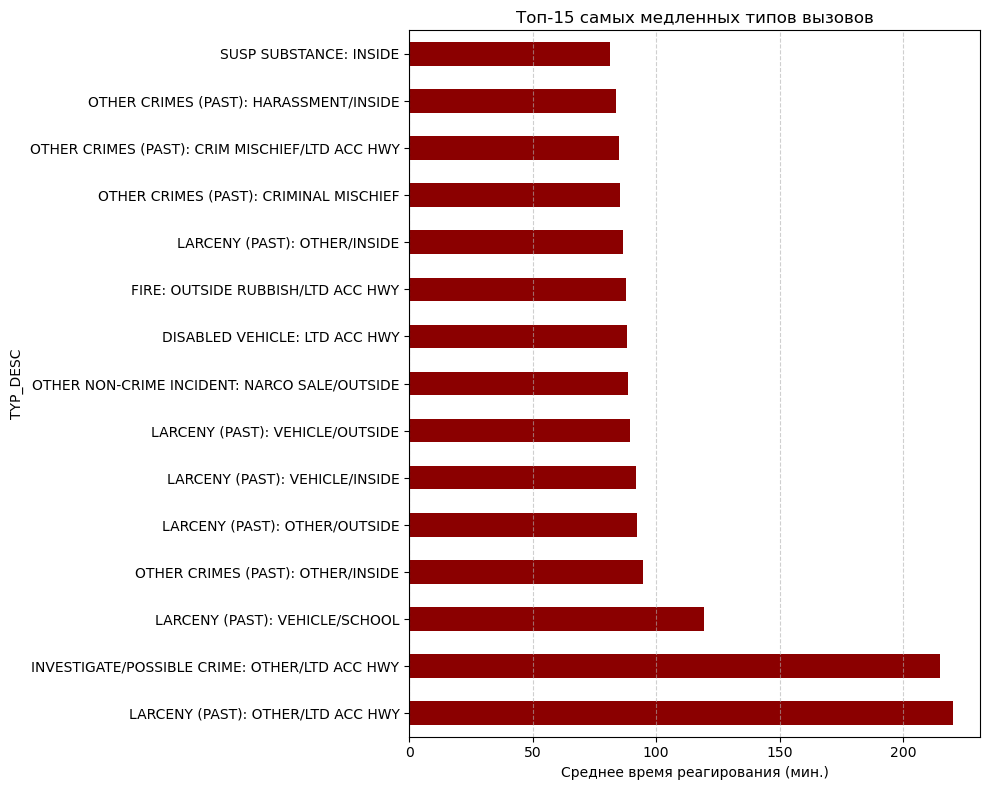

In [241]:
avg_response = df.groupby("TYP_DESC")["response_min"].mean().sort_values(ascending=False).head(15)
plt.figure(figsize=(10, 8))
avg_response.plot(kind='barh', color='darkred', title="Топ-15 самых медленных типов вызовов")
plt.xlabel("Среднее время реагирования (мин.)")
plt.grid(axis='x', linestyle='--', alpha=0.6); plt.tight_layout();

 Длительное реагирование связано в основном с инцидентами, которые произошли в прошлом (PAST) или с **низким приоритетом (OTHER, LIMITED ACCESS HIGHWAY)`.

"PAST" (прошедшие преступления) → часто фиксируются задним числом (например, заявка о краже машины через несколько часов).

"OTHER" или "LTD ACC HWY" (ограниченные шоссе) → сложная логистика (плохо доступные места или специфические обстоятельства).

"DISABLED VEHICLE", "OUTSIDE RUBBISH" → низкий приоритет, нет угрозы жизни → можно ехать позже.

In [243]:
df["weekday"] = df["CREATE_DATE"].dt.day_name()
df.groupby("weekday").size().reindex(
    ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
)

weekday
Monday       83349
Tuesday      79548
Wednesday    83640
Thursday     84528
Friday       89394
Saturday     83948
Sunday       80538
dtype: int64

In [245]:
calls_by_weekday = df.groupby("weekday").size().reindex([
    "Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"
])

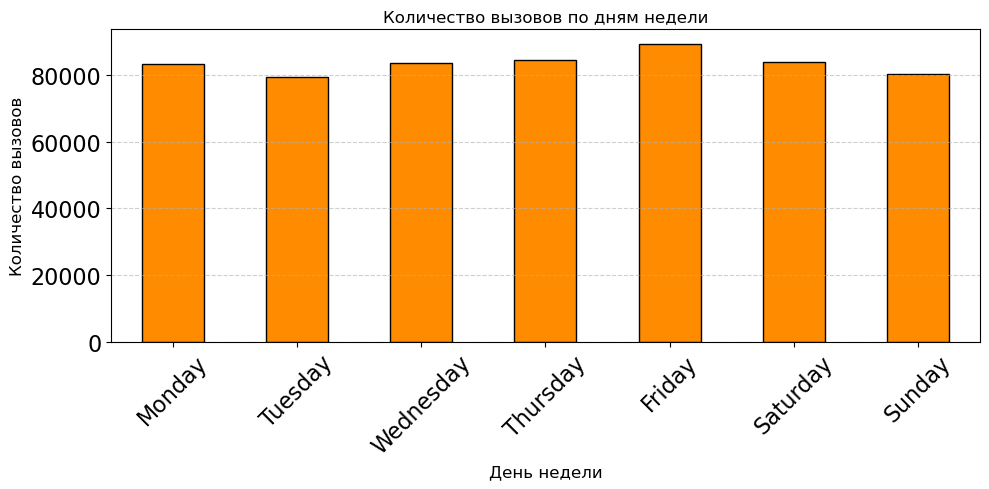

In [247]:
plt.figure(figsize=(10, 5))
calls_by_weekday.plot(kind="bar", color="darkorange", edgecolor="black", title="Количество вызовов по дням недели", fontsize=16)

plt.xlabel("День недели", fontsize=12)
plt.ylabel("Количество вызовов", fontsize=12)
plt.xticks(rotation=45); plt.grid(axis="y", linestyle="--", alpha=0.6); plt.tight_layout();

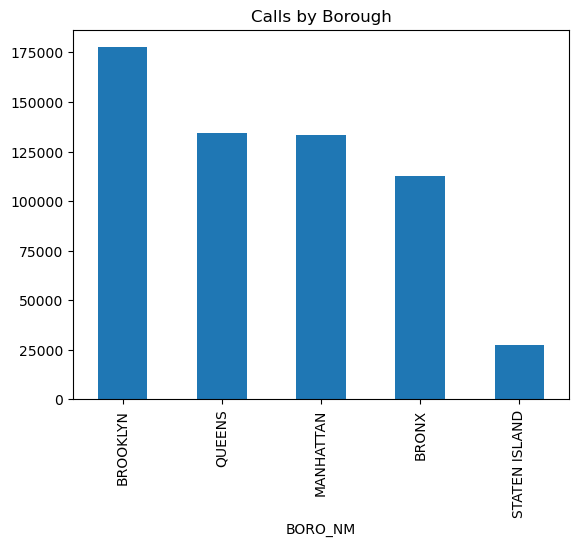

In [250]:
import folium
from folium.plugins import HeatMap

# Basic incident count by borough
df['BORO_NM'].value_counts().plot(kind='bar', title="Calls by Borough")

# Map Heatmap of incident locations
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)
heat_data = df[['Latitude', 'Longitude']].dropna().values.tolist()
HeatMap(heat_data, radius=10).add_to(m)
m

C:\Users\rusla\AppData\Local\Temp\ipykernel_108852\3446507772.py:4: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df['CLOSNG_TS'] = pd.to_datetime(df['CLOSNG_TS'])


<Axes: title={'center': 'Avg. Response Time by Precinct'}, xlabel='NYPD_PCT_CD'>

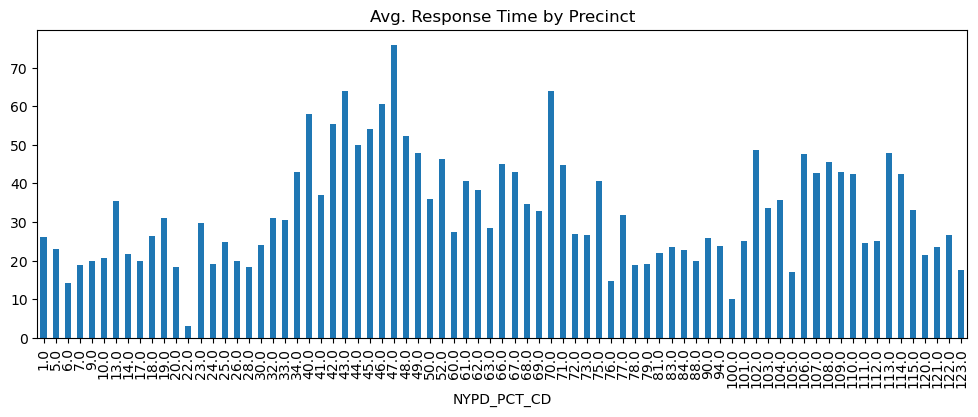

In [83]:
df['DISP_TS'] = pd.to_datetime(df['DISP_TS'])
df['ARRIVD_TS'] = pd.to_datetime(df['ARRIVD_TS'])
df['CLOSNG_TS'] = pd.to_datetime(df['CLOSNG_TS'])
df['Response_Time_Min'] = (df['ARRIVD_TS'] - df['DISP_TS']).dt.total_seconds() / 60
df.groupby('NYPD_PCT_CD')['Response_Time_Min'].mean().plot(kind='bar', figsize=(12, 4), title="Avg. Response Time by Precinct")


Text(0.5, 1.0, 'Call Frequency by Hour and Borough')

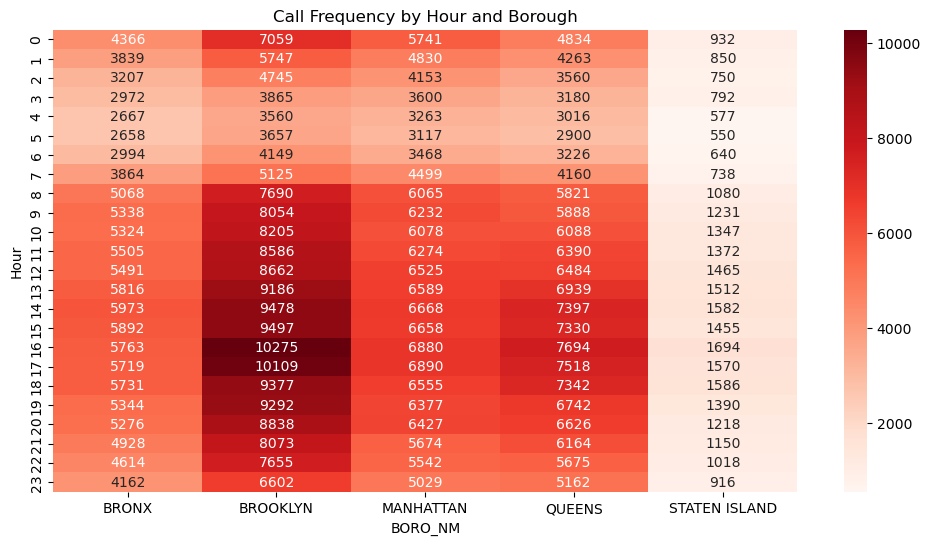

In [84]:
df['Day'] = df['INCIDENT_DATE'].dt.day_name()
heat_data = pd.crosstab(df['Hour'], df['BORO_NM'])

plt.figure(figsize=(12, 6))
sns.heatmap(heat_data, cmap="Reds", annot=True, fmt="d")
plt.title("Call Frequency by Hour and Borough")


In [122]:
gdf = gpd.read_file("nypp_25a/nypp.shp")

gdf['Precinct'] = gdf['Precinct'].astype(int) 

gdf.to_file("nypd_precincts.geojson", driver="GeoJSON")

In [116]:
precinct_counts = df['NYPD_PCT_CD'].value_counts().reset_index()
precinct_counts.columns = ['Precinct', 'Call_Count']

In [182]:
m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)
folium.Choropleth(
    geo_data="nypd_precincts.geojson",
    data=precinct_counts,
    columns=["Precinct", "Call_Count"],
    key_on="feature.properties.Precinct",  
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.3,
    legend_name="NYPD Calls per Precinct"
).add_to(m)

folium.GeoJson(
    "nypd_precincts.geojson",
    name="Precincts",
    tooltip=folium.GeoJsonTooltip(fields=["Precinct"])
).add_to(m)

m

In [162]:
import json

with open("nypd_precincts.geojson") as f:
    data = json.load(f)

# See the property names of the first feature
print(data['features'][0]['properties'])


{'Precinct': '1', 'Shape_Leng': 80093.4903098, 'Shape_Area': 47284748.3277}


In [178]:
precinct_counts['Precinct'] = precinct_counts['Precinct'].astype(str)


In [176]:
precinct_counts.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   Precinct    77 non-null     int32
 1   Call_Count  77 non-null     int64
dtypes: int32(1), int64(1)
memory usage: 1.0 KB


In [164]:
print(set(precinct_counts['Precinct']) - set(gdf['Precinct']))

{'66.0', '106.0', '23.0', '110.0', '120.0', '7.0', '104.0', '109.0', '26.0', '28.0', '77.0', '1.0', '68.0', '20.0', '47.0', '62.0', '50.0', '44.0', '105.0', '84.0', '13.0', '79.0', '121.0', '9.0', '10.0', '115.0', '76.0', '78.0', '70.0', '81.0', '18.0', '102.0', '61.0', '100.0', '43.0', '103.0', '41.0', '113.0', '49.0', '123.0', '73.0', '88.0', '30.0', '111.0', '101.0', '83.0', '60.0', '33.0', '34.0', '52.0', '90.0', '17.0', '19.0', '114.0', '107.0', '25.0', '72.0', '32.0', '14.0', '45.0', '122.0', '71.0', '46.0', '94.0', '24.0', '6.0', '42.0', '40.0', '67.0', '48.0', '112.0', '5.0', '108.0', '69.0', '63.0', '75.0', '22.0'}


In [188]:
gdf = gpd.read_file("nypp_25a/nypp.shp")
gdf = gdf.to_crs(epsg=4326)
gdf['Precinct'] = gdf['Precinct'].astype(str)
gdf.to_file("nypd_precincts.geojson", driver="GeoJSON")

In [264]:
# Get top 3 incident types
top_types = df['TYP_DESC'].value_counts().nlargest(3).index.tolist()
print("Top Incident Types:", top_types)

Top Incident Types: ['SEE COMPLAINANT: OTHER/INSIDE', 'INVESTIGATE/POSSIBLE CRIME: CALLS FOR HELP/INSIDE', 'VISIBILITY PATROL: DIRECTED']


In [266]:
top_types

['SEE COMPLAINANT: OTHER/INSIDE',
 'INVESTIGATE/POSSIBLE CRIME: CALLS FOR HELP/INSIDE',
 'VISIBILITY PATROL: DIRECTED']

In [284]:
type_maps = {}

for incident in top_types:
    type_df = df[df['TYP_DESC'] == incident]
    counts = type_df['NYPD_PCT_CD'].value_counts().reset_index()
    counts.columns = ['Precinct', 'Call_Count']
    counts['Precinct'] = counts['Precinct'].astype(float)
    counts['Precinct'] = counts['Precinct'].astype(int)
    counts['Precinct'] = counts['Precinct'].astype(str)
    type_maps[incident] = counts


In [286]:
type_maps

{'SEE COMPLAINANT: OTHER/INSIDE':    Precinct  Call_Count
 0        84         917
 1        68         861
 2        67         790
 3        83         789
 4        44         732
 ..      ...         ...
 72       26         193
 73       10         177
 74       28         177
 75       17         113
 76       22          28
 
 [77 rows x 2 columns],
 'INVESTIGATE/POSSIBLE CRIME: CALLS FOR HELP/INSIDE':    Precinct  Call_Count
 0       109         888
 1        75         878
 2       110         794
 3        52         787
 4        67         782
 ..      ...         ...
 72       78         194
 73        6         184
 74      123         163
 75       76         140
 76       22          22
 
 [77 rows x 2 columns],
 'VISIBILITY PATROL: DIRECTED':    Precinct  Call_Count
 0       120        1858
 1        73        1007
 2        84         861
 3       121         768
 4        63         764
 ..      ...         ...
 72       18         140
 73       13          76
 74   

In [276]:
import re

In [288]:
for incident, precinct_data in type_maps.items():
    m = folium.Map(location=[40.7128, -74.0060], zoom_start=11)

    folium.Choropleth(
        geo_data="nypd_precincts.geojson",
        data=precinct_data,
        columns=["Precinct", "Call_Count"],
        key_on="feature.properties.Precinct",
        fill_color="PuBuGn",
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f"{incident} Calls per Precinct"
    ).add_to(m)

    # Optional tooltip overlay
    folium.GeoJson(
        "nypd_precincts.geojson",
        name="Precincts",
        tooltip=folium.GeoJsonTooltip(fields=["Precinct"])
    ).add_to(m)
    safe_name = re.sub(r'[^a-zA-Z0-9]+', '_', incident)
    m.save(f"{safe_name}_map.html")
